<div style="text-align:left;">
    <img src="https://upload.wikimedia.org/wikipedia/commons/thumb/5/58/Uber_logo_2018.svg/1024px-Uber_logo_2018.svg.png" alt="Uber logo" width="300px" style="margin-left: 0px;"/>
</div>

<br><br>

`Uber` est l'une des startups les plus célèbres au monde. Elle a commencé en tant qu'application de covoiturage pour les personnes qui ne pouvaient pas se permettre un taxi. Aujourd'hui, Uber a étendu ses activités à la livraison de nourriture avec Uber Eats, la livraison de colis, le transport de fret et même le transport urbain avec Jump Bike et Lime, que l'entreprise a financés.

Un des principaux problèmes que l'équipe d'Uber a constaté est que parfois les `chauffeurs` ne sont pas disponibles lorsque les utilisateurs en ont besoin. Par conséquent, l'équipe de données d'Uber souhaite travailler sur un projet où leur `application recommanderait des zones chaudes dans les grandes villes à tout moment de la journée`.


Uber dispose déjà de données sur les prises en charge dans les grandes villes. L'objectif est de créer des algorithmes qui détermineront où se trouvent les zones chaudes où les chauffeurs devraient se trouver en mettant en place:

- Créer un algorithme pour trouver les zones chaudes
- Visualiser les résultats sur un tableau de bord

# 0 - Load

In [12]:
import pandas as pd
import numpy as np
import warnings
from sklearn.neighbors import NearestNeighbors
from matplotlib import pyplot as plt

# Plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import plotly.figure_factory as ff

# Scikit-learn
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.compose import ColumnTransformer
from sklearn.metrics import silhouette_score

In [13]:
def describe_df(df):

    print('number of rows:',len(df))

    print('Display of dataset:')
    display(df.head())

    print('Basic statistics:')
    display(df.describe(include="all"))


    print('Pourcentage of missing values:')
    display(df.isnull().sum()/len(df)*100)

# 1 - Preprocessing

Les données fournis sont structurés de la manière suivantes:

```

├── data/ 
    ├── uber-raw-data-janjun-15/
    │   └── uber-raw-data-janjun-15.csv
    │ 
    ├── taxi-zone-lookup.csv
    └── uber-raw-data-apr14.csv
    └── uber-raw-data-aug14.csv
    └── uber-raw-data-jul14.csv
    └── uber-raw-data-jun14.csv
    └── uber-raw-data-may14.csv
    └── uber-raw-data-sep14.csv
    
```

Pour rappel l'objectif est d'identifier des hotspots, ceci à l'aide d'informations geographiques (latitude - longitude) et temporelles (Year - Month - day - hour). C'est pour cela que les informations contenu dans les fichiers `uber-raw-data-janjun-15.csv` et `taxi-zone-lookup.csv` ne renseigne pas les informations précédemment requises comme peuvent le faire tous les autres fichiers. C'est pourquoi nous les écartons pour la suite du projet.  

Au vu de la quantités massives de données dans chaque fichiers mensuel (de 600k à 1M de lignes), je prends le partie de me focaliser sur une sample de 100 000 lignes du premier mois à notre disposition (`uber-raw-data-apr14.csv`), pour des raisons évidentes de capicités de machine. C'est pourquoi dans la suite du preprocessing je me focile uniquement sur les informations de jours et heures. Si nous étions amenés à travailler sur plusieurs mois/années il faudrait intégrer ces dimensions dans les différentes étapes qui consituent ce projet.

La description du dataset présente qu'aucune données n'est manquante.

In [14]:
df_raw = pd.read_csv('data/uber-raw-data-apr14.csv')
df = df_raw.sample(100_000)
# df = df_raw
describe_df(df)

number of rows: 100000
Display of dataset:


,Date/Time,Lat,Lon,Base
243042,4/7/2014 12:50:00,40.7473,-73.9889,B02617
30263,4/27/2014 9:38:00,40.7222,-73.9971,B02512
239517,4/6/2014 1:45:00,40.7439,-74.0069,B02617
345760,4/3/2014 17:49:00,40.7239,-73.9963,B02682
272101,4/15/2014 20:35:00,40.7620,-73.9695,B02617


Basic statistics:


,Date/Time,Lat,Lon,Base
count,100000,100000.000000,100000.000000,100000
unique,33339,NaN,NaN,5
top,4/30/2014 21:10:00,NaN,NaN,B02682
freq,19,NaN,NaN,40450
mean,NaN,40.739947,-73.976914,NaN
std,NaN,0.035830,0.050454,NaN
min,NaN,40.267800,-74.655800,NaN
25%,NaN,40.722500,-73.997700,NaN
50%,NaN,40.742700,-73.984600,NaN
75%,NaN,40.760700,-73.969900,NaN


Pourcentage of missing values:


Date/Time    0.0
Lat          0.0
Lon          0.0
Base         0.0
dtype: float64

In [15]:
date = 'Date/Time'
df['Date/Time'] = pd.to_datetime(df['Date/Time'])
df['dayofweek'] = df[date].dt.dayofweek
df['hour'] = df[date].dt.hour
df.drop('Date/Time',axis=1,inplace=True)
df.drop('Base',axis=1,inplace=True)

In [16]:
fig = px.density_mapbox(df.sort_values('dayofweek'),lat="Lat",lon="Lon",animation_frame='dayofweek', mapbox_style="carto-positron",radius=3)
fig.update_layout(width=1000, height=550)
fig.show()

Cette `density mapbox` donne une première idée de la répartition des prises en charge par les `chauffeurs Uber à New York`. On voit se dessiner des zones fréquentées tout au long de la semaine mais nous ferons une analyse plus poussées lors de la définition de nos clusters.

# 2 - Kmeans

Afin d'identifier des clusters nous allons utiliser 2 méthodes: `Kmeans` et `DBScan`. Notre première méthode requiert un paramètre de nombre de clusters. L'objectif est d'itérer sur des `Kmeans` avec différentes valeurs de nombre de clusters (k). Pour identifier le meilleur k, nous devons utiliser des outils empiriques que sont l'`elbow` et le `silhouette score`.

- `elbow`: Cette méthode implique de tracer le nombre de clusters par rapport à une mesure de la variation intra-cluster afin d'observer le point où la diminution de cette variation commence à se stabiliser, formant ainsi une courbe qui ressemble à un coude. Ce point est généralement considéré comme le nombre optimal de clusters.
- `silhouette score`: il quantifie à quel point chaque objet d'un cluster est similaire à ses propres membres par rapport aux membres des autres clusters.

Notons que cette méthode est extremement chronophage puisqu'elle recquiert de faire autant de modèle que d'itération. Au vu de notre graphe le nombre idéal de cluster semble si situé entre 3 et 5.

In [17]:
active=False

if active:
    X = df
    sil = []
    k = []
    wcss =  []
    for i in range (2,11): 
        kmeans = KMeans(n_clusters= i, random_state = 0, n_init='auto')
        kmeans.fit(X)
        wcss.append(kmeans.inertia_)
        sil.append(silhouette_score(X, kmeans.predict(X)))
        k.append(i)
    
    k_choice = pd.DataFrame({'k':k, 'WCSS':wcss, 'Silhouette Score':sil}).set_index('k')
    k_choice  

    import plotly.graph_objects as go
    figs = go.Figure()

    figs.add_trace(go.Scatter(
        x = k_choice.index, 
        y = k_choice['WCSS'], 
        name = 'WCSS', 
        mode = 'lines', 
        xaxis = 'x', 
        yaxis = 'y',
    ))

    figs.add_trace(go.Bar(
        x = k_choice.index, 
        y = k_choice['Silhouette Score'], 
        name = 'Silhouette Score', 
        xaxis = 'x', 
        yaxis = 'y2',
        opacity = 0.7
    ))

    figs.update_layout(
        xaxis = go.layout.XAxis(title_text = 'K', tickvals = k_choice.index),
        yaxis = go.layout.YAxis(title_text = 'WCSS', color = 'blue'),
        yaxis2 = go.layout.YAxis(title_text = 'Silhouette Score', anchor = 'x', side = 'right', overlaying = 'y', color = 'red'),
        showlegend = True,
        legend_xanchor = 'left',
        legend_x = 1.2,
        legend_font_size = 14,
        autosize = False,
        title_text = 'Choice of optimal K value',
        title_x = 0.5,
        height = 500,
        width = 900
    )

    figs.show()

<div style="text-align:center;">
    <img src="./img/optimal-k_sil_wcss.png" alt="Uber logo" width="700px" style="margin-left: 0px;"/>
</div>

In [18]:
kmeans = KMeans(n_clusters=3,random_state=0)
kmeans.fit(df)
df['Cluster_KMeans'] = kmeans.predict(df)

fig = px.scatter_mapbox(df,lat="Lat",lon="Lon",color='Cluster_KMeans', mapbox_style="carto-positron")
fig.update_layout(width=1000)
fig.show()

In [19]:
kmeans = KMeans(n_clusters=5,random_state=0)
kmeans.fit(df)
df['Cluster_KMeans'] = kmeans.predict(df)

fig = px.scatter_mapbox(df,lat="Lat",lon="Lon",color='Cluster_KMeans', mapbox_style="carto-positron")
fig.update_layout(width=1000)
fig.show()

Cette méthode semble avoir ses limites. En plus du temps de calcul, l'identification de cluster nous renseigne très peu. Les clusters semblent quadriller la ville sans renseigner d'informations spatio-temporelles pertinentes. Peut-être que le "bon" nombre de cluster se situe au-dela de 10, mais pour le savoir il faudrait tester chaque possibilité. 

# 3 - DBScan

La seconde technique à notre disposition identifie les clusters de manière à se propager de proche en proche en fonction de deux hyperparamètres. Le `min_sample` qui fixe le nombre minimum de voisin que doit avoir un point pour appartenir au cluster et l'`eps` qui contraint un rayon d'action dans lequel ce nombre de voisins doivent se trouver. Pour identifier ces deux paramètres une méthode empirique (<a href="https://www.sefidian.com/2022/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/">source</a>) montre que le min_sample semble valoir au alentours de `2*nombre_de_feature`. 

Pour identifier `eps` la méthode proposée consiste à calculer les distances des k plus proches voisins dans une matrice de points. L'idée est de calculer la moyenne des distances de chaque point à ses k voisins les plus proches. La valeur de k sera spécifiée par l'utilisateur et correspond à `min_sample`. Ensuite, ces distances k sont tracées dans l'ordre croissant. L'objectif est de déterminer le "coude", qui correspond au paramètre epsilon optimal. Un coude correspond à un seuil où un changement brusque se produit le long de la courbe des distances k.

## Pipeline

In [20]:
categorical_features = ['hour']
numeric_features = ['Lon','Lat']

numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(drop="first")

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

X = preprocessor.fit_transform(df)

## Identification d'epsilon et min_sample.

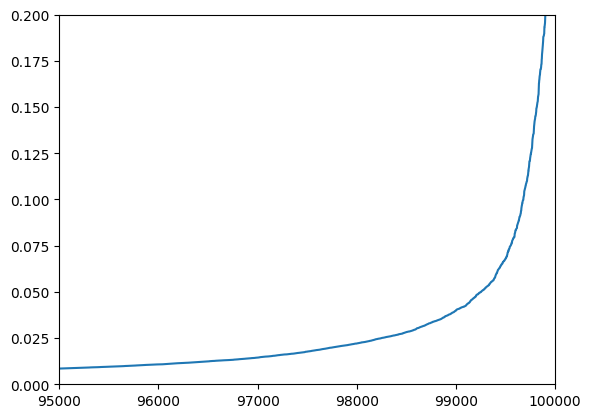

In [21]:
neighbors = NearestNeighbors(n_neighbors=8)
neighbors_fit = neighbors.fit(df)
distances, indices = neighbors_fit.kneighbors(df)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.ylim(0, 0.2)
plt.xlim(95_000, 100_000)
plt.plot(distances)

Afin de faciliter la manipulations des données et d'éviter de recalculer le modèle un fihcier csv est chargé dans df.

In [22]:
active=False

if active:
    Eps = 0.05
    Min_samples = 10
    db = DBSCAN(eps=Eps, min_samples=Min_samples)
    db.fit(X)
    df['cluster'] = db.labels_
    print(set(db.labels_))
else:
    # df = pd.read_csv('df_without_outlier_02_10.csv')
    df = pd.read_csv('df_without_outlier_005_10.csv')
    print()

Dans un premier temps, nous affichons un graphe sans les valeurs aberrantes. Un curseur permet d'explorer jour par jour, avec un dégradé de couleurs indiquant les heures auxquelles les chauffeurs ont pris leurs clients. Bien que ce graphe ne révèle pas explicitement les clusters identifiés par DBSCAN, nous pouvons déjà noter deux observations :

- Les aéroports se distinguent clairement.
- Les clients semblent davantage recourir aux services Uber à des heures tardives pendant le week-end.

In [23]:
df_without_outlier = df[df['cluster']!=-1]

day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df_without_outlier['dayofweek_name'] = df_without_outlier['dayofweek'].map(lambda x: day_names[x])

In [24]:
fig = go.Figure()

for chosen_day in range(7):
    mask = df_without_outlier['dayofweek'] == chosen_day
    scatter = go.Scattermapbox(
        lat=df_without_outlier[mask]['Lat'],
        lon=df_without_outlier[mask]['Lon'],
        mode='markers',
        marker=dict(
            size=10,
            color=df_without_outlier[mask]['hour'],
            colorscale='Viridis',
            cmin=df_without_outlier['hour'].min(),
            cmax=df_without_outlier['hour'].max(),
            colorbar=dict(title='Hour')
        ),
        name=day_names[chosen_day]
    )
    fig.add_trace(scatter)

# Set up slider
steps = []
for i in range(7):
    step = dict(
        method="update",
        args=[{"visible": [False] * 7}],
        label=day_names[i]
    )
    step["args"][0]["visible"][i] = True 
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Day: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    mapbox=dict(
        style="carto-positron",
        zoom=10,
        center=dict(lat=df_without_outlier['Lat'].mean(), lon=df_without_outlier['Lon'].mean())
    ),
    sliders=sliders,
    width=1000,
    height=700,
    title='Example Scatter Map'
)
fig.update_traces(showlegend=False)

fig.show()


Ensuite, un curseur permet d'explorer heure par heure, avec un dégradé de couleurs indiquant les jours auxquelles les chauffeurs ont pris leurs clients. C'est la visualisation précédentes inversée.

Avec cette visualisation, on peut remarquer que la demande de les Uber sont fortement sollicités entre minuit et 3h du matin dans la nuit du samedi au dimanche, avec des zones comme williamburg ou brooklyn, qui sont des zones dynamiques le samedi soir. Entre 5h et 9h manhattan est fortement sollicités pendant les 5 premiers jours de la semaine comparer au week-end.

L'objectif est de combiné ces deux graphes en intégrant un double slider permettant de gérer l'heure et le jour, nous utiliserons le gradient de couleur pour identifier les clusters. Ceci vas nous permettre d'analyser plus en détail les activités et mouvement de la poulation new yorkaise.

In [25]:
fig = go.Figure()

for chosen_hour in range(24):
    mask = df_without_outlier['hour'] == chosen_hour
    scatter = go.Scattermapbox(
        lat=df_without_outlier[mask]['Lat'],
        lon=df_without_outlier[mask]['Lon'],
        mode='markers',
        marker=dict(
            size=10,
            color=df_without_outlier[mask]['dayofweek'],
            colorscale='Viridis',
            cmin=df_without_outlier['dayofweek'].min(),
            cmax=df_without_outlier['dayofweek'].max(),
            colorbar=dict(title='dayofweek')
        ),
        name=chosen_hour
    )
    fig.add_trace(scatter)

steps = []
for i in range(24):
    step = dict(
        method="update",
        args=[{"visible": [False] * 24}],
        label=i
    )
    step["args"][0]["visible"][i] = True
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Hour: "},
    pad={"t": 50},
    steps=steps
)]
fig.update_traces(showlegend=False)

fig.update_layout(
    mapbox=dict(
        style="carto-positron",
        zoom=10,
        center=dict(lat=df_without_outlier['Lat'].mean(), lon=df_without_outlier['Lon'].mean())
    ),
    sliders=sliders,
    width=1000,
    height=700,
    title='Day Density, slider hour/hour'
)

fig.show()


In [26]:
fig = go.Figure()

for chosen_day in range(7):
    for chosen_hour in range(24):
        mask = (df_without_outlier['dayofweek'] == chosen_day) & (df_without_outlier['hour'] == chosen_hour)
        scatter = go.Scattermapbox(
            lat=df_without_outlier[mask]['Lat'],
            lon=df_without_outlier[mask]['Lon'],
            mode='markers',
            marker=dict(
                size=10,
                color=df_without_outlier[mask]['cluster'],
                colorscale='Viridis',
                cmin=df_without_outlier['cluster'].min(),
                cmax=df_without_outlier['cluster'].max(),
                colorbar=dict(title='Cluster')
            ),
            name=f"{day_names[chosen_day]} - {chosen_hour}:00",
            opacity = 0.7

        )
        fig.add_trace(scatter)

    day_steps = []
    for i in range(7):
        step = dict(
            method="update",
            args=[{"visible": [False] * 168}],  # 7j * 24h = 168 fig
            label=day_names[i]
        )
        for j in range(i * 24, (i + 1) * 24):  
            step["args"][0]["visible"][j] = True
        day_steps.append(step)

    day_slider = dict(
        active=0,
        currentvalue={"prefix": "Day: "},
        pad={"t": 30},
        steps=day_steps,
        x=0,
        xanchor="left",
        y=-0.35,
        yanchor="bottom"
    )

    hour_steps = []
    for i in range(24):
        step = dict(
            method="update",
            args=[{"visible": [False] * 168}],  # 7j * 24h = 168 fig
            label=f"{i}:00"
        )
        for j in range(i, 168, 24):
            step["args"][0]["visible"][j] = True
        hour_steps.append(step)

    hour_slider = dict(
        active=0,
        currentvalue={"prefix": "Hour: "},
        pad={"t": 30},
        steps=hour_steps,
        x=0,
        xanchor="left",
        y=-0.15,
        yanchor="bottom"
    )

sliders = [day_slider, hour_slider]

fig.update_layout(
    mapbox=dict(
        style="carto-positron",
        zoom=10,
        center=dict(lat=df_without_outlier['Lat'].mean(), lon=df_without_outlier['Lon'].mean())
    ),
    sliders=sliders,
    width=1000,
    height=800,
    title='Choose hour and day to see clusters'
)
fig.update_traces(showlegend=False)


fig.show()


Notre double sliders ne fonctionne pas. Il faudrait pouvoir récupérer les informations actualisée de notre slider et le réutiliser pour ajuster notre mask et les valeurs que l'on souhaite afficher. Après recherche il est existe dash plotly qui permet de réaliser ces interfaces. A l'aide de callback nous avons accès à cette information actualisée. 

In [35]:
import dash
from dash import dcc, html, Input, Output

app = dash.Dash(__name__)
app.layout = html.Div([
    html.Label('Choose a day:'),
    dcc.Slider(
        id='day-slider',
        min=0,
        max=6,
        value=0,
        marks={i: day for i, day in enumerate(day_names)},
        step=None,
        included=False,
    ),
    html.Label('Choose an hour:'),
    dcc.Slider(
        id='hour-slider',
        min=0,
        max=23,
        value=0,
        marks={i: f"{i}h" for i in range(24)},
        step=None,
    ),
    dcc.Graph(id='map-graph')
], style={'color': 'white', 'width':'60%'}) #change color if your have not a dark theme

@app.callback(
    Output('map-graph', 'figure'),
    [Input('day-slider', 'value'),
     Input('hour-slider', 'value')]
)
def update_graph(chosen_day, chosen_hour):
    # Filter the data based on selected day and hour
    mask = (df_without_outlier['dayofweek'] == chosen_day) & (df_without_outlier['hour'] == chosen_hour)
    filtered_data = df_without_outlier[mask]
    
    fig = go.Figure(go.Scattermapbox(
        lat=filtered_data['Lat'],
        lon=filtered_data['Lon'],
        mode='markers',
        marker=dict(
            size=10,
            color=filtered_data['cluster'],
            colorscale='Viridis',
            cmin=df_without_outlier['cluster'].min(),
            cmax=df_without_outlier['cluster'].max(),
            colorbar=dict(title='Cluster')
        ),
        name=f"{day_names[chosen_day]} - {chosen_hour}:00",
        opacity=0.7
    ))
    
    fig.update_layout(
        mapbox=dict(
            style="carto-positron",
            zoom=10,
            center=dict(lat=filtered_data['Lat'].mean(), lon=filtered_data['Lon'].mean())
        ),
        width=1000,
        height=600,
        title=f'Data for {day_names[chosen_day]} - {chosen_hour}:00'
    )
    
    return fig

app.run_server()


Comme sur l'heatmap au début du notebook, on identifie des hotspots mais ici nous gagnons en précision dans notre analyse. Nous pouvons identitifer par jour et heure, quelles sont les zones les plus fréquentés sur lesquels les chauffeurs doivent se concentrer.

Sur cette visualisations beaucoup d'informations et de zones stratégiques ressortent:
	- Central Park s'identifie facilement de part son absence d'activité,
	- Les aéroports (JFK, Newak Liberty, Laguardia) sont très fréquentés à toutes heures et jour de la semaine.
	- Une éparation Upper/Lower manhattan (jour, heure, activités reliées)
	- Dowtown Brooklyn (jazz, rooftop, pont)
	- Williamsbourg (comedy, concert)

# Annexe - save model to csv

In [30]:
# df_without_outlier.to_csv(f'df_without_outlier_005_8.csv')


# Conclusion

Pour rappel, l'un des principaux problèmes que l'équipe d'Uber a constatés est que parfois les `chauffeurs` ne sont pas disponibles lorsque les utilisateurs en ont besoin. Par conséquent, l'équipe de données d'Uber souhaite travailler sur un projet où leur application recommanderait des `zones chaudes` dans les grandes `villes` à tout moment de la journée.

Uber dispose déjà de données sur les prises en charge dans les grandes villes. L'objectif est de créer des algorithmes qui détermineront où se trouvent les zones chaudes où les `chauffeurs` devraient se trouver, en commençant par New York.

La première approche avec `Kmeans` ne fournit pas des informations aussi précises qu'avec `DBScan`, où nous sommes capables de mettre en évidence des `hotspots` géographiques en lien avec des activités tout au long de la semaine.

1. `Sensibilité à la forme des clusters` : KMeans suppose que les clusters sont de forme sphérique et de taille égale, ce qui peut ne pas être le cas dans des données réelles comme les données de localisation des prises en charge d'Uber. En revanche, DBScan peut détecter des clusters de formes arbitraires et de densités variables.

2. `Détermination du nombre de clusters` : KMeans nécessite de spécifier le nombre de clusters à l'avance, ce qui peut être difficile à déterminer de manière objective. Cela peut conduire à des résultats suboptimaux si le nombre de clusters choisi n'est pas approprié. DBScan, en revanche, peut identifier le nombre de clusters de manière automatique en se basant sur des critères tels que la densité des points.

3. `Sensibilité aux valeurs aberrantes` : KMeans est sensible aux valeurs aberrantes et peut être influencé par elles lors de la définition des centroids des clusters. Cela peut conduire à des clusters mal positionnés ou à une sous-performance de l'algorithme. DBScan, en revanche, est plus robuste aux valeurs aberrantes grâce à sa méthode de détection basée sur la densité.

4. `Performance dans des clusters de densités variables` : KMeans peut avoir du mal à gérer des clusters de densités variables, où certains clusters sont plus denses que d'autres. Cela peut conduire à une mauvaise segmentation des données. DBScan, quant à lui, peut s'adapter efficacement à des clusters de densités variables en définissant les clusters en fonction de la densité locale des points.

En résumé, bien que KMeans soit un algorithme de clustering largement utilisé et efficace dans de nombreux cas, il présente des limitations dans le contexte spécifique de la recommandation de hot zones pour Uber, où les données de localisation peuvent avoir des clusters de formes et de densités variables. Dans de telles situations, `DBScan est une meilleure alternative` grâce à sa capacité à détecter des `clusters` de `forme arbitraire` et de `densité variable`, ainsi qu'à sa `robustesse aux valeurs aberrantes`.

Grâce à cette méthode nous avons relevé des informations intéressantes à différents lieux et instants à `New York` (activités professionnelles ou de loisirs à Downtown Brooklyn, Williamsburg, aéroports, Upper/Lower Manhattan). Cette méthode est fonctionnelle sur notre jeu de données d'avril 2014 et pourrait être `généralisable` sur plusieurs mois voire années, afin de `dégager des tendances`. Par exemple, il est probable que les comportements de la population varient entre l'hiver et l'été, entraînant des changements dans les hotspots. En explorant différentes échelles temporelles, nous pourrions affiner davantage notre analyse et augmenter sa pertinence.
